# <font color='Orange'>List Python/R packages available under NCI-geophys</font>  

In [1]:
! conda list 

# packages in environment at /opt/conda/envs/geophys:
#
# Name                    Version                   Build  Channel
_libgcc_mutex             0.1                 conda_forge    conda-forge
_openmp_mutex             4.5                       2_gnu    conda-forge
_py-xgboost-mutex         2.0                       cpu_0    conda-forge
_r-mutex                  1.0.1               anacondar_1    conda-forge
_sysroot_linux-64_curr_repodata_hack 3                   h69a702a_13    conda-forge
access                    1.1.8              pyhd8ed1ab_0    conda-forge
affine                    2.4.0              pyhd8ed1ab_0    conda-forge
afterimage                1.21              ha9998ff_1003    conda-forge
aiobotocore               2.5.0              pyhd8ed1ab_0    conda-forge
aiohttp                   3.8.4            py39h72bdee0_0    conda-forge
aiohttp-cors              0.7.0                      py_0    conda-forge
aioitertools              0.11.0             pyhd8ed1ab_0    co

# <font color='Orange'>Obspy</font> 

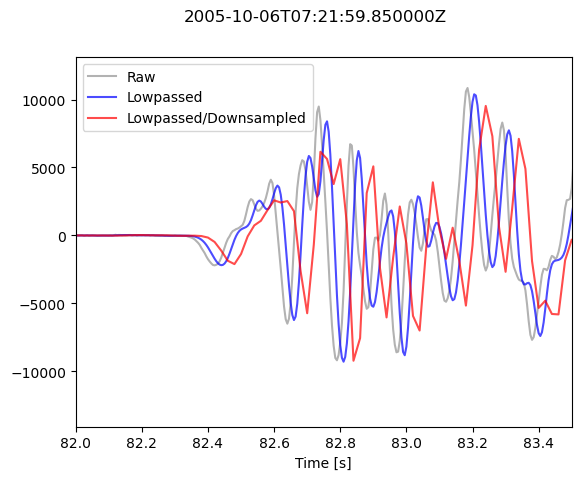

In [2]:
### Downsampling Seismograms

import numpy as np
import matplotlib.pyplot as plt

import obspy

# Read the seismogram
st = obspy.read("https://examples.obspy.org/RJOB_061005_072159.ehz.new")

# There is only one trace in the Stream object, let's work on that trace...
tr = st[0]

# Decimate the 200 Hz data by a factor of 4 to 50 Hz. Note that this
# automatically includes a lowpass filtering with corner frequency 20 Hz.
# We work on a copy of the original data just to demonstrate the effects of
# downsampling.
tr_new = tr.copy()
tr_new.decimate(factor=4, strict_length=False)

# For comparison also only filter the original data (same filter options as in
# automatically applied filtering during downsampling, corner frequency
# 0.4 * new sampling rate)
tr_filt = tr.copy()
tr_filt.filter('lowpass', freq=0.4 * tr.stats.sampling_rate / 4.0)

# Now let's plot the raw and filtered data...
t = np.arange(0, tr.stats.npts / tr.stats.sampling_rate, tr.stats.delta)
t_new = np.arange(0, tr_new.stats.npts / tr_new.stats.sampling_rate,
                  tr_new.stats.delta)

plt.plot(t, tr.data, 'k', label='Raw', alpha=0.3)
plt.plot(t, tr_filt.data, 'b', label='Lowpassed', alpha=0.7)
plt.plot(t_new, tr_new.data, 'r', label='Lowpassed/Downsampled', alpha=0.7)
plt.xlabel('Time [s]')
plt.xlim(82, 83.5)
plt.suptitle(tr.stats.starttime)
plt.legend()
plt.show()

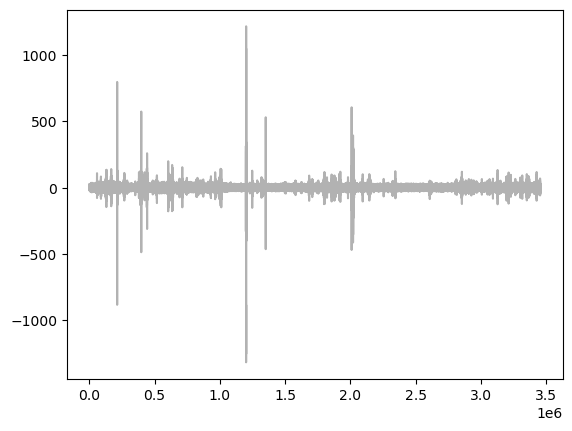

In [3]:
### qt52 data

import numpy as np
import matplotlib.pyplot as plt

import obspy

# Example seismogram under /g/data/qt52
example_file = '/g/data/qt52/AusPass_Passive_Seismic/2003/AU/CMSA/SHZ.D/AU.CMSA..SHZ.D.2003.192'

st = obspy.read(example_file)

# There is only one trace in the Stream object, let's work on that trace...
tr = st[0]
plt.plot(tr, 'k', label='Raw', alpha=0.3)


/opt/conda/envs/geophys/lib/python3.9/site-packages/obspy/imaging/beachball.py:186: UserWarning: There is a known bug when plotting semi-transparent patches for non-DC sources, which leads to blending of pressure and tension color, see issue #1464.
  warnings.warn(msg)


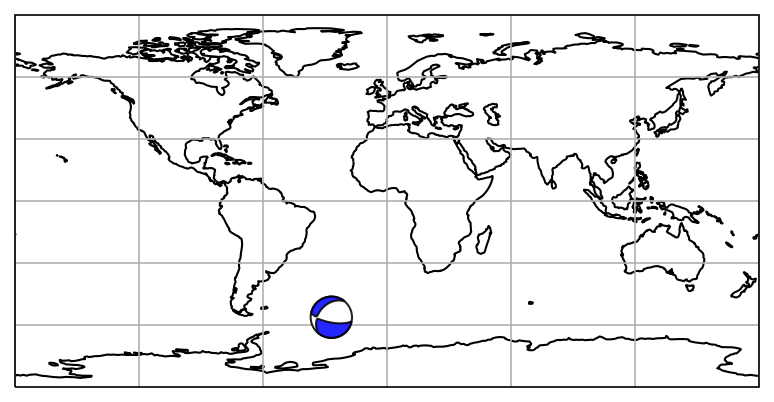

In [4]:
### Cartopy plots

import matplotlib.pyplot as plt
import cartopy.crs as ccrs

from obspy import read_events
from obspy.imaging.beachball import beach


event = read_events(
    'https://earthquake.usgs.gov/product/moment-tensor/'
    'us_20005ysu_mww/us/1470868224040/quakeml.xml', format='QUAKEML')[0]
origin = event.preferred_origin() or event.origins[0]
focmec = event.preferred_focal_mechanism() or event.focal_mechanisms[0]
tensor = focmec.moment_tensor.tensor
moment_list = [tensor.m_rr, tensor.m_tt, tensor.m_pp,
               tensor.m_rt, tensor.m_rp, tensor.m_tp]

projection = ccrs.PlateCarree(central_longitude=0.0)
x, y = projection.transform_point(x=origin.longitude, y=origin.latitude,
                                  src_crs=ccrs.Geodetic())

fig = plt.figure(dpi=150)
ax = fig.add_subplot(111, projection=projection)
ax.set_extent((-180, 180, -90, 90))
ax.coastlines()
ax.gridlines()

b = beach(moment_list, xy=(x, y), width=20, linewidth=1, alpha=0.85, zorder=10)
b.set_zorder(10)
ax.add_collection(b)

fig.show()

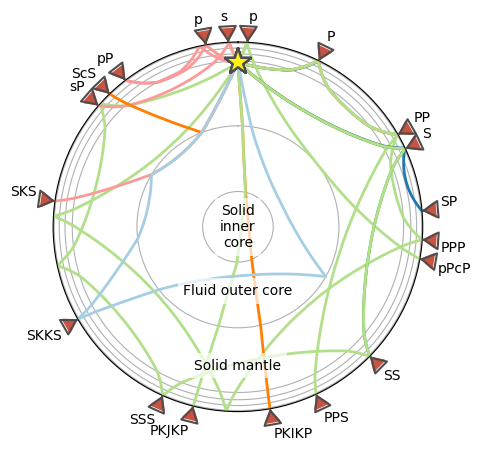

In [5]:
### Travel time and Ray path plotting

import numpy as np
import matplotlib.pyplot as plt

from obspy.taup import TauPyModel


PHASES = [
    # Phase, distance
    ('P', 26),
    ('PP', 60),
    ('PPP', 94),
    ('PPS', 155),
    ('p', 3),
    ('pPcP', 100),
    ('PKIKP', 170),
    ('PKJKP', 194),
    ('S', 65),
    ('SP', 85),
    ('SS', 134.5),
    ('SSS', 204),
    ('p', -10),
    ('pP', -37.5),
    ('s', -3),
    ('sP', -49),
    ('ScS', -44),
    ('SKS', -82),
    ('SKKS', -120),
]

model = TauPyModel(model='iasp91')

fig, ax = plt.subplots(subplot_kw=dict(polar=True))

# Plot all pre-determined phases
for phase, distance in PHASES:
    arrivals = model.get_ray_paths(700, distance, phase_list=[phase])
    ax = arrivals.plot_rays(plot_type='spherical',
                            legend=False, label_arrivals=True,
                            plot_all=True,
                            show=False, ax=ax)

# Annotate regions
ax.text(0, 0, 'Solid\ninner\ncore',
        horizontalalignment='center', verticalalignment='center',
        bbox=dict(facecolor='white', edgecolor='none', alpha=0.7))
ocr = (model.model.radius_of_planet -
       (model.model.s_mod.v_mod.iocb_depth +
        model.model.s_mod.v_mod.cmb_depth) / 2)
ax.text(np.deg2rad(180), ocr, 'Fluid outer core',
        horizontalalignment='center',
        bbox=dict(facecolor='white', edgecolor='none', alpha=0.7))
mr = model.model.radius_of_planet - model.model.s_mod.v_mod.cmb_depth / 2
ax.text(np.deg2rad(180), mr, 'Solid mantle',
        horizontalalignment='center',
        bbox=dict(facecolor='white', edgecolor='none', alpha=0.7))

plt.show()

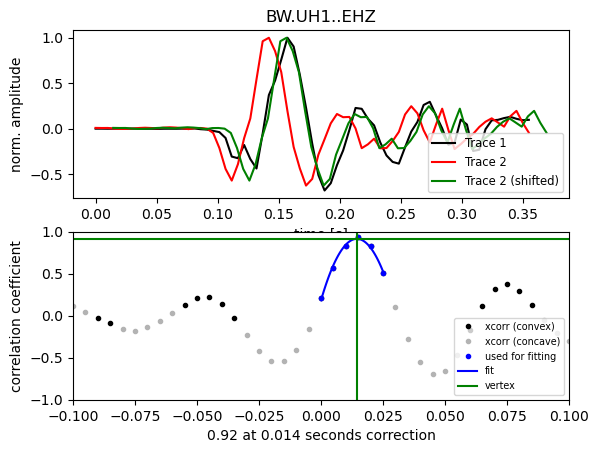

No preprocessing:
  Time correction for pick 2: -0.014459
  Correlation coefficient: 0.92


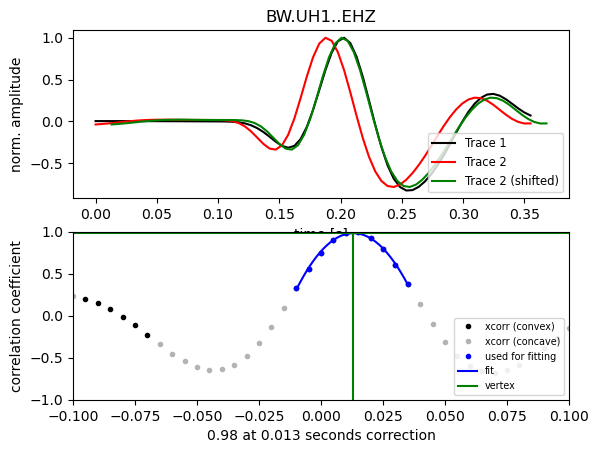

Bandpass prefiltering:
  Time correction for pick 2: -0.013025
  Correlation coefficient: 0.98


In [6]:
### Cross-correlation Pick Correction

from __future__ import print_function

import obspy
from obspy.signal.cross_correlation import xcorr_pick_correction


# read example data of two small earthquakes
path = "https://examples.obspy.org/BW.UH1..EHZ.D.2010.147.%s.slist.gz"
st1 = obspy.read(path % ("a", ))
st2 = obspy.read(path % ("b", ))
# select the single traces to use in correlation.
# to avoid artifacts from preprocessing there should be some data left and
# right of the short time window actually used in the correlation.
tr1 = st1.select(component="Z")[0]
tr2 = st2.select(component="Z")[0]
# these are the original pick times set during routine analysis
t1 = obspy.UTCDateTime("2010-05-27T16:24:33.315000Z")
t2 = obspy.UTCDateTime("2010-05-27T16:27:30.585000Z")

# estimate the time correction for pick 2 without any preprocessing and open
# a plot window to visually validate the results
dt, coeff = xcorr_pick_correction(t1, tr1, t2, tr2, 0.05, 0.2, 0.1, plot=True)
print("No preprocessing:")
print("  Time correction for pick 2: %.6f" % dt)
print("  Correlation coefficient: %.2f" % coeff)
# estimate the time correction with bandpass prefiltering
dt, coeff = xcorr_pick_correction(t1, tr1, t2, tr2, 0.05, 0.2, 0.1, plot=True,
                                  filter="bandpass",
                                  filter_options={'freqmin': 1, 'freqmax': 10})
print("Bandpass prefiltering:")
print("  Time correction for pick 2: %.6f" % dt)
print("  Correlation coefficient: %.2f" % coeff)

# <font color='Orange'>Pyrocko</font>

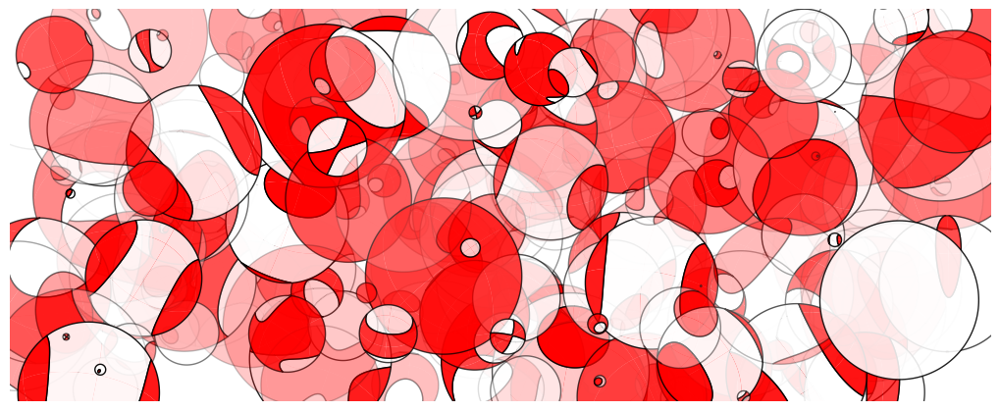

In [7]:
### Plotting beachballs

import random
import logging
import os
from matplotlib import pyplot as plt
from pyrocko import moment_tensor as pmt
from pyrocko import util
from pyrocko.plot import beachball

''' Beachball Copacabana '''

logger = logging.getLogger('pyrocko.examples.beachball_example01')

util.setup_logging()

fig = plt.figure(figsize=(10., 4.))
fig.subplots_adjust(left=0., right=1., bottom=0., top=1.)
axes = fig.add_subplot(1, 1, 1)

for i in range(200):

    # create random moment tensor
    mt = pmt.MomentTensor.random_mt()

    try:
        # create beachball from moment tensor
        beachball.plot_beachball_mpl(
            mt, axes,
            # type of beachball: deviatoric, full or double couple (dc)
            beachball_type='full',
            size=random.random()*120.,
            position=(random.random()*10., random.random()*10.),
            alpha=random.random(),
            linewidth=1.0)

    except beachball.BeachballError as e:
        logger.error('%s for MT:\n%s' % (e, mt))

axes.set_xlim(0., 10.)
axes.set_ylim(0., 10.)
axes.set_axis_off()

plt.show()

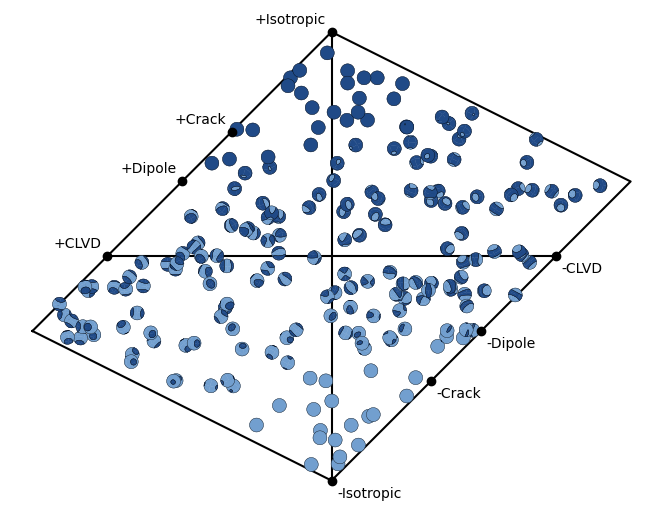

In [8]:
from __future__ import print_function
import sys
from matplotlib import pyplot as plt
from pyrocko.plot import hudson, beachball, mpl_init, mpl_color
from pyrocko import moment_tensor as pmt

# a bunch of random MTs
moment_tensors = [pmt.random_mt() for _ in range(200)]

# setup plot layout
fontsize = 10.
markersize = fontsize
mpl_init(fontsize=fontsize)
width = 7.
figsize = (width, width / (4. / 3.))
fig = plt.figure(figsize=figsize)
axes = fig.add_subplot(1, 1, 1)
fig.subplots_adjust(left=0.03, right=0.97, bottom=0.03, top=0.97)

# draw focal sphere diagrams for the random MTs
for mt in moment_tensors:
    u, v = hudson.project(mt)
    try:
        beachball.plot_beachball_mpl(
            mt, axes,
            beachball_type='full',
            position=(u, v),
            size=markersize,
            color_t=mpl_color('skyblue3'),
            color_p=mpl_color('skyblue1'),
            alpha=1.0,  # < 1 for transparency
            zorder=1,
            linewidth=0.25)

    except beachball.BeachballError as e:
        print(str(e), file=sys.stderr)

# draw the axes and annotations of the hudson plot
hudson.draw_axes(axes)
plt.show()

# <font color='Orange'>MTpy</font> 

In [9]:
from mtpy.core.mt import MT
from mtpy.core.z import Z, Tipper
from mtpy.analysis.geometry import dimensionality
from mtpy.analysis.geometry import strike_angle
from mtpy.imaging.plotstrike import PlotStrike
from mtpy.imaging import penetration_depth2d as pen2d
from mtpy.imaging import penetration_depth3d as pen3d
from mtpy.imaging.phase_tensor_maps import PlotPhaseTensorMaps
from mtpy.imaging.plot_resphase_maps import PlotResPhaseMaps
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
import os

In [10]:
edi = '/g/data/my80/AuScope_MT_collection/The_University_of_Adelaide_Legacy_MT_collection/States_and_Territories/SA/Broadband/Paralana_July_2011/EDI/500Hz/pb02c.edi'

In [11]:
mt = MT(edi)

In [12]:
print(mt.Z.z[:2])

[[[ -0.924215  -1.212873j   25.65522  +34.75997j  ]
  [-27.7503   -36.69583j     0.4688475 +0.2550878j]]

 [[ -0.4513743 -0.7673443j  21.7967   +28.44744j  ]
  [-21.7876   -30.13736j    -0.3032393 +0.2358288j]]]


In [13]:
print(mt.Z.freq)

[7.812500e+01 6.250000e+01 4.687500e+01 3.906250e+01 3.125000e+01
 2.343750e+01 1.953125e+01 1.562500e+01 1.171875e+01 9.765625e+00
 7.812500e+00 6.250000e+00 4.687500e+00 3.906250e+00 3.125000e+00
 2.343750e+00 1.953125e+00 1.562500e+00 1.171875e+00 9.765630e-01
 7.812500e-01 5.859380e-01 4.882810e-01 3.906250e-01 2.929690e-01
 2.441410e-01 1.953130e-01 1.464840e-01 1.220700e-01 9.765600e-02
 7.324200e-02 6.103500e-02 4.882800e-02 3.662100e-02 3.051800e-02
 2.441400e-02 1.831100e-02 1.525900e-02 1.220700e-02 9.155000e-03
 7.629000e-03 6.104000e-03 4.578000e-03]


No Tipper data for station pb02


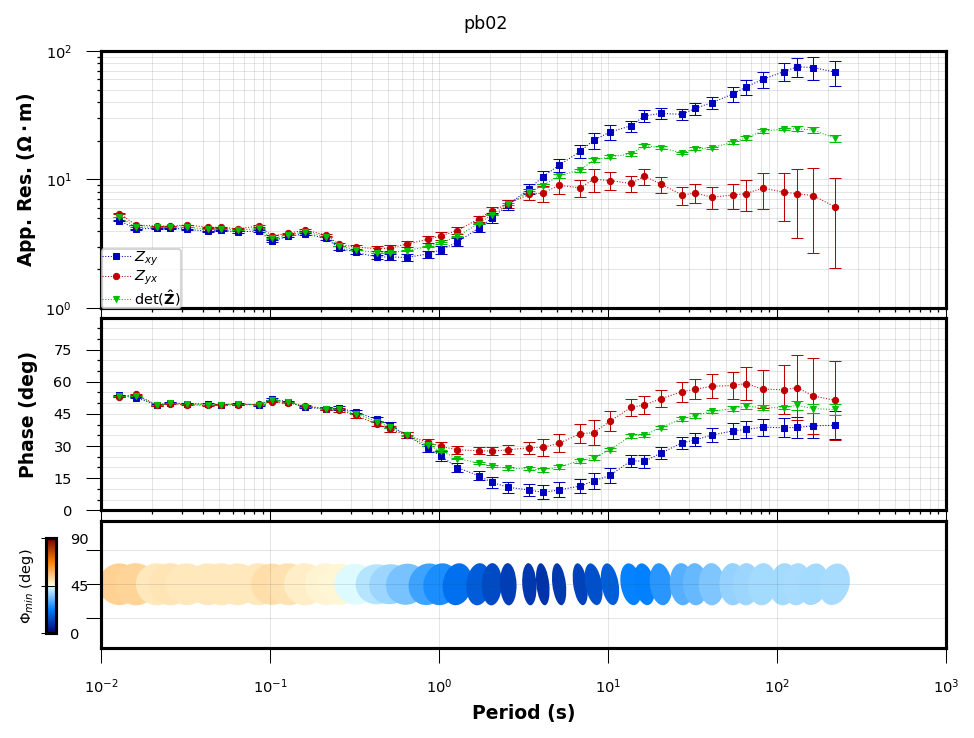

In [14]:
pt = mt.plot_mt_response(plot_num=3,plot_pt='y')
#pt = mt.plot_mt_response(plot_num=2,plot_tipper='yri',plot_pt='y')

In [15]:
print(dimensionality(z_object=mt.Z, skew_threshold = 5, eccentricity_threshold=0.1))

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 3 3 3 3 3 2 3 2 2 2 2 2
 2 2 2 2 2 2]


In [16]:
### OCCAM2D

import mtpy.modeling.occam2d_rewrite as occam2d
from mtpy.modeling.occam2d_rewrite import PlotModel

#edipath = '/g/data/up99/admin/testing/mtpy_test/edi1'

edipath = '/g/data/my80/AuScope_MT_collection/The_University_of_Adelaide_Legacy_MT_collection/States_and_Territories/SA/Broadband/Paralana_July_2011/EDI/500Hz'
slst = sorted([edi[0:-4] for edi in os.listdir(edipath) if edi.find('c.edi')>0])
print(slst)

savepath = str(Path.home())+ '/' + 'nci-geophys-test'
if not os.path.exists(savepath):
    os.mkdir(savepath)
    
occampath =  str(Path.home())+ '/' + 'nci-geophys-test' + '/' + 'occam_test'
if not os.path.exists(occampath):
    os.mkdir(occampath)



['pb01c', 'pb02c', 'pb03c', 'pb04c', 'pb05c', 'pb06c', 'pb07c', 'pb08c', 'pb09c', 'pb10c', 'pb11c', 'pb12c', 'pb13c', 'pb14c', 'pb15c', 'pb16c', 'pb17c', 'pb21c', 'pb23c', 'pb24c', 'pb25c', 'pb26c', 'pb27c', 'pb28c', 'pb29c', 'pb30c', 'pb31c', 'pb32c', 'pb33c', 'pb35c', 'pb36c', 'pb37c', 'pb38c', 'pb39c', 'pb40c', 'pb41c', 'pb42c', 'pb43c', 'pb44c', 'pb45c', 'pb46c', 'pb47c', 'pb48c', 'pb49c', 'pb50c', 'pb51c', 'pb52c', 'pb54c', 'pb55c']


In [17]:
ocd = occam2d.Data(edi_path=edipath,
station_list=slst,
interpolate_freq=True, # interpolate frequencies
freq=np.logspace(-3,3,37) # frequency list
)
ocd.save_path = occampath

/opt/conda/envs/geophys/lib/python3.9/site-packages/mtpy-1.1.5-py3.9.egg/mtpy/modeling/occam2d_rewrite.py:1098: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  main_utmzone = mode(utm_zones)[0][0]


Rotated Z and Tipper to align with +0.10 degrees E of N
Profile angle is +90.10 degrees E of N


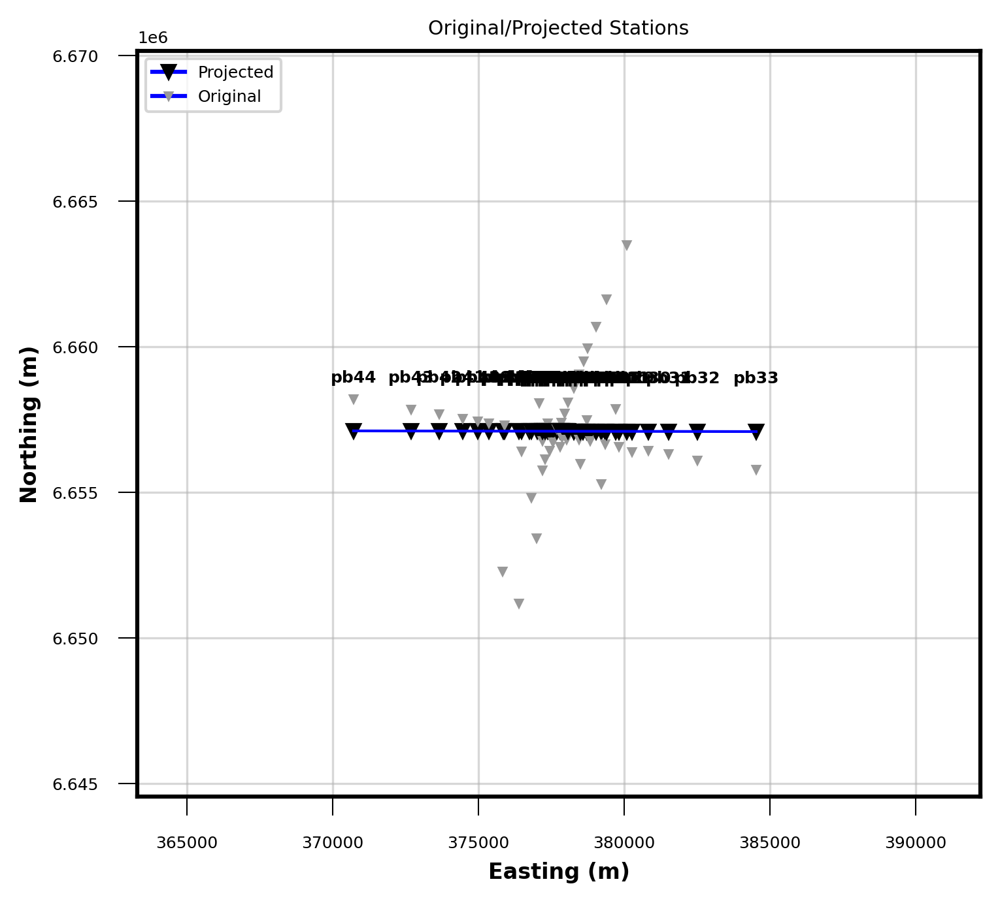

/opt/conda/envs/geophys/lib/python3.9/site-packages/mtpy-1.1.5-py3.9.egg/mtpy/utils/calculator.py:371: RuntimeWarning: invalid value encountered in double_scalars
  z_rel_err = error/z_amp


Wrote Occam2D data file to /home/900/nre900/nci-geophys-test/occam_test/OccamDataFile.dat


In [18]:
ocd.geoelectric_strike = 0.1
ocd.res_te_err = 10 # error floor
ocd.res_tm_err = 10
ocd.phase_te_err = 5
ocd.phase_tm_err = 5
ocd.model_mode = '1'
keepdims = 'True'
ocd.write_data_file()

                    MESH PARAMETERS                    
  number of horizontal nodes = 178
  number of vertical nodes   = 90
  Total Horizontal Distance  = 28591.790461
  Total Vertical Distance    = 293170.000000
               REGULARIZATION PARAMETERS               
   binding offset       = 0.0
   number layers        = 85
   number of parameters = 4640
   number of free param = 4640
                    MESH PARAMETERS                    
  number of horizontal nodes = 66
  number of vertical nodes   = 60
  Total Horizontal Distance  = 904891.384986
  Total Vertical Distance    = 358330.000000
               REGULARIZATION PARAMETERS               
   binding offset       = 0.0
   number layers        = 55
   number of parameters = 651
   number of free param = 651
Wrote Mesh file to /home/900/nre900/nci-geophys-test/occam_test/Occam2DMesh
Wrote Regularization file to /home/900/nre900/nci-geophys-test/occam_test/Occam2DModel


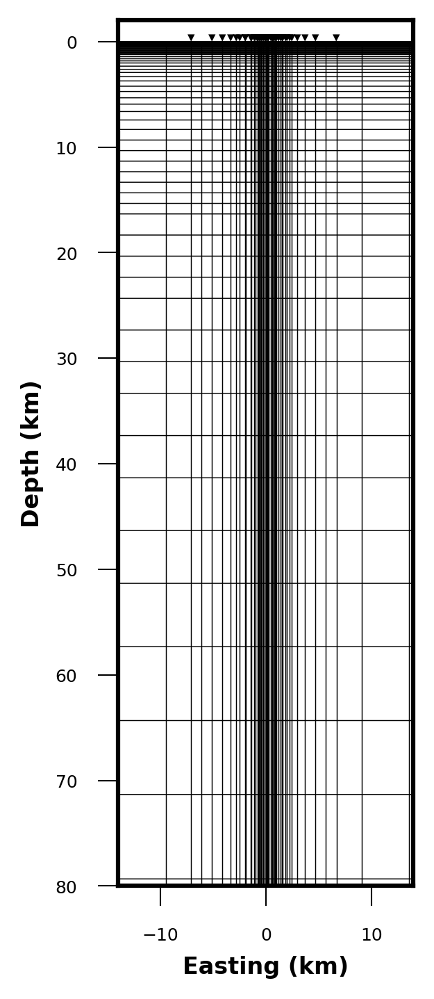

In [19]:
# make model and mesh files
ocr = occam2d.Regularization(ocd.station_locations)
ocr.n_layers = 60 # number of layers
ocr.cell_width = 1250 # cell width to aim for, note this is the
# mesh size (2 mesh blocks across per model block)
ocr.x_pad_multiplier = 1.9 # controls size of padding
ocr.trigger= 0.25 # controls aspect ratio of blocks
ocr.z_bottom = 200000 # bottom of model
ocr.z1_layer = 50 # z1 layer and target depth in metres
ocr.z_target_depth = 80000 # target depth for inversion
ocr.save_path=ocd.save_path
ocr.build_mesh()
ocr.build_regularization()
ocr.write_mesh_file()
ocr.write_regularization_file()
ocr.plot_mesh() 

In [20]:
# make startup file
ocs=occam2d.Startup()
ocs.iterations_to_run=5
ocs.resistivity_start=2.0 # log10(starting resistivity)
ocs.target_misfit = 1.2
ocs.data_fn=os.path.join(ocd.data_fn)
ocr.get_num_free_params()
ocs.param_count=ocr.num_free_param
ocs.save_path=ocd.save_path
ocs.model_fn=ocr.reg_fn
ocs.write_startup_file()

Wrote Occam2D startup file to /home/900/nre900/nci-geophys-test/occam_test/Occam2DStartup


In [21]:
os.chdir(occampath)

#### To run this Occam inversion, open up a terminal on Gadi or JupyterLab and run:

`$ module use /g/data/up99/modulefiles`

`$ module load occam2D/3.0`

`$ cd ~/nci-geophys-test/occam_test`
 
`$ Occam2D Occam2DStartup`

### Plotting results of Occam inversion

Reading from OccamDataFile.dat
    profile_angle = 90.1
    geoelectric_strike = 0.1
    number of sites = 49
    number of frequencies = 37


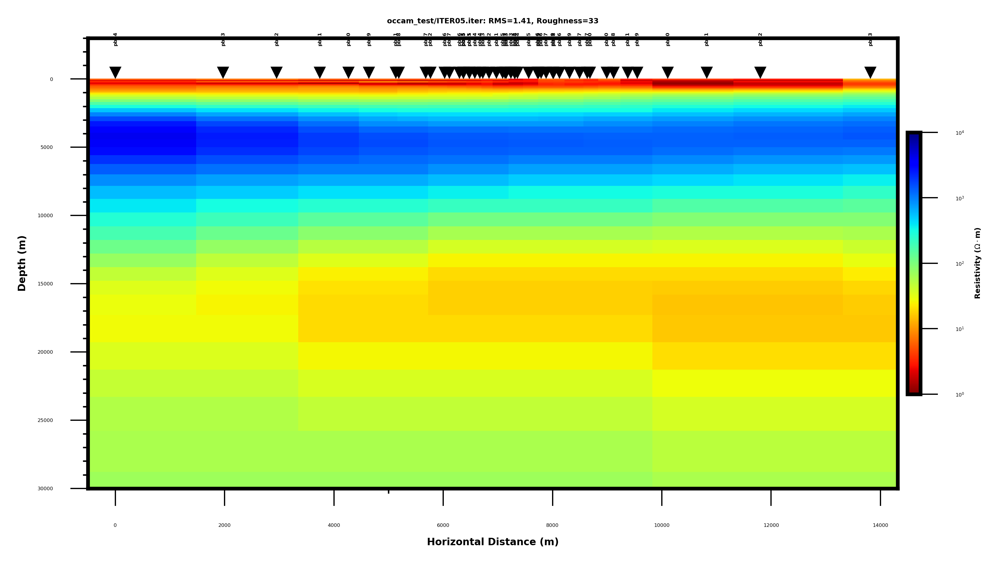

In [22]:
iterfile = "ITER05.iter"
datafn = "OccamDataFile.dat"

pltm = PlotModel(iter_fn=os.path.join(occampath,iterfile),
data_fn=os.path.join(savepath,datafn),
station_font_pad = 2.5, 
station_font_size = 2, 
station_font_rotation = 90,
font_size=2, 
climits=(0,4), 
cb_shrink= 0.3, 
xpad=0.5, 
yscale = 'm', 
yminorticks = 1.,
dpi=600, 
fig_aspect = 0.25, 
ylimits = (-2,30), 
stationid=(-1,3)) 

# <font color='Orange'>SimPEG</font> 

In [23]:
from SimPEG.utils import plot2Ddata, surface2ind_topo, model_builder
from SimPEG.potential_fields import gravity
from SimPEG import (
    maps,
    data,
    data_misfit,
    inverse_problem,
    regularization,
    optimization,
    directives,
    inversion,
    utils,
)

import matplotlib as mpl
import matplotlib.pyplot as plt
import tarfile

from discretize import TensorMesh

In [24]:
### simpeg example data dir
data_dir = '/g/data/up99/sandbox/nci-geophysics/simpeg/gravity'
os.chdir(data_dir)

# path to the directory containing our data
dir_path = data_dir.split(".")[0] + os.path.sep

# files to work with
topo_filename = dir_path + "gravity_topo.txt"
data_filename = dir_path + "gravity_data.obs"

### Load Data and Plot

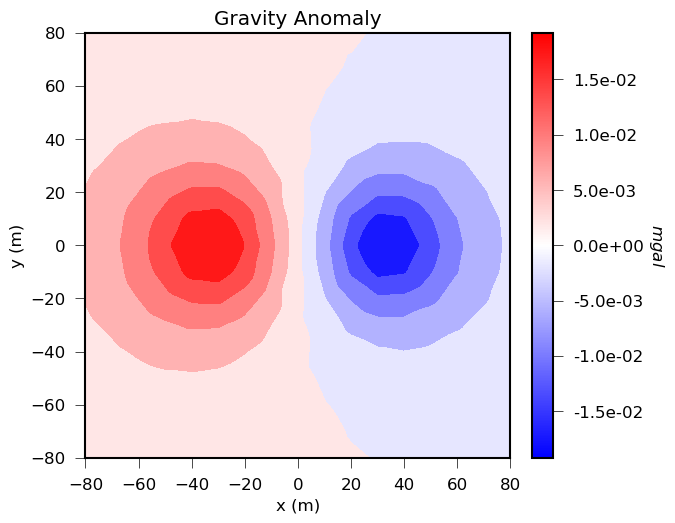

In [25]:
# Load topography
xyz_topo = np.loadtxt(str(topo_filename))

# Load field data
dobs = np.loadtxt(str(data_filename))

# Define receiver locations and observed data
receiver_locations = dobs[:, 0:3]
dobs = dobs[:, -1]

# Plot
mpl.rcParams.update({"font.size": 12})
fig = plt.figure(figsize=(7, 5))

ax1 = fig.add_axes([0.1, 0.1, 0.73, 0.85])
plot2Ddata(receiver_locations, dobs, ax=ax1, contourOpts={"cmap": "bwr"})
ax1.set_title("Gravity Anomaly")
ax1.set_xlabel("x (m)")
ax1.set_ylabel("y (m)")

ax2 = fig.add_axes([0.8, 0.1, 0.03, 0.85])
norm = mpl.colors.Normalize(vmin=-np.max(np.abs(dobs)), vmax=np.max(np.abs(dobs)))
cbar = mpl.colorbar.ColorbarBase(
    ax2, norm=norm, orientation="vertical", cmap=mpl.cm.bwr, format="%.1e"
)
cbar.set_label("$mgal$", rotation=270, labelpad=15, size=12)

plt.show()

### Assign Uncertainties

In [26]:
maximum_anomaly = np.max(np.abs(dobs))

uncertainties = 0.01 * maximum_anomaly * np.ones(np.shape(dobs))

### Define the Survey

In [27]:
# Define the receivers. The data consists of vertical gravity anomaly measurements.
# The set of receivers must be defined as a list.
receiver_list = gravity.receivers.Point(receiver_locations, components="gz")

receiver_list = [receiver_list]

# Define the source field
source_field = gravity.sources.SourceField(receiver_list=receiver_list)

# Define the survey
survey = gravity.survey.Survey(source_field)

### Defining the Data

In [28]:
data_object = data.Data(survey, dobs=dobs, standard_deviation=uncertainties)

### Defining a Tensor Mesh

In [29]:
dh = 5.0
hx = [(dh, 5, -1.3), (dh, 40), (dh, 5, 1.3)]
hy = [(dh, 5, -1.3), (dh, 40), (dh, 5, 1.3)]
hz = [(dh, 5, -1.3), (dh, 15)]
mesh = TensorMesh([hx, hy, hz], "CCN")

### Starting/Reference Model and Mapping on Tensor Mesh

In [30]:
# Define density contrast values for each unit in g/cc. Don't make this 0!
# Otherwise the gradient for the 1st iteration is zero and the inversion will
# not converge.
background_density = 1e-6

# Find the indices of the active cells in forward model (ones below surface)
ind_active = surface2ind_topo(mesh, xyz_topo)

# Define mapping from model to active cells
nC = int(ind_active.sum())
model_map = maps.IdentityMap(nP=nC)  # model consists of a value for each active cell

# Define and plot starting model
starting_model = background_density * np.ones(nC)

### Define the Physics

In [31]:
simulation = gravity.simulation.Simulation3DIntegral(
    survey=survey, mesh=mesh, rhoMap=model_map, ind_active=ind_active
)

### Define the Inverse Problem

In [32]:
# Define the data misfit. Here the data misfit is the L2 norm of the weighted
# residual between the observed data and the data predicted for a given model.
# Within the data misfit, the residual between predicted and observed data are
# normalized by the data's standard deviation.
dmis = data_misfit.L2DataMisfit(data=data_object, simulation=simulation)

# Define the regularization (model objective function).
reg = regularization.WeightedLeastSquares(mesh, indActive=ind_active, mapping=model_map)

# Define how the optimization problem is solved. Here we will use a projected
# Gauss-Newton approach that employs the conjugate gradient solver.
opt = optimization.ProjectedGNCG(
    maxIter=10, lower=-1.0, upper=1.0, maxIterLS=20, maxIterCG=10, tolCG=1e-3
)

# Here we define the inverse problem that is to be solved
inv_prob = inverse_problem.BaseInvProblem(dmis, reg, opt)

/opt/conda/envs/geophys/lib/python3.9/site-packages/SimPEG/utils/code_utils.py:629: FutureWarning: active_cells.indActive has been deprecated, please use active_cells. It will be removed in version 0.19.0 of SimPEG.
  warnings.warn(message, FutureWarning)
/opt/conda/envs/geophys/lib/python3.9/site-packages/SimPEG/utils/code_utils.py:638: FutureWarning: active_cells.indActive has been deprecated, please use active_cells. It will be removed in version 0.19.0 of SimPEG.
  warnings.warn(message, FutureWarning)


### Define Inversion Directives

In [33]:
# Defining a starting value for the trade-off parameter (beta) between the data
# misfit and the regularization.
starting_beta = directives.BetaEstimate_ByEig(beta0_ratio=1e1)

# Defining the fractional decrease in beta and the number of Gauss-Newton solves
# for each beta value.
beta_schedule = directives.BetaSchedule(coolingFactor=5, coolingRate=1)

# Options for outputting recovered models and predicted data for each beta.
save_iteration = directives.SaveOutputEveryIteration(save_txt=False)

# Updating the preconditionner if it is model dependent.
update_jacobi = directives.UpdatePreconditioner()

# Setting a stopping criteria for the inversion.
target_misfit = directives.TargetMisfit(chifact=1)

# Add sensitivity weights
sensitivity_weights = directives.UpdateSensitivityWeights(everyIter=False)

# The directives are defined as a list.
directives_list = [
    sensitivity_weights,
    starting_beta,
    beta_schedule,
    save_iteration,
    update_jacobi,
    target_misfit,
]

### Running the Inversion

In [34]:
# Here we combine the inverse problem and the set of directives
inv = inversion.BaseInversion(inv_prob, directives_list)

# Run inversion
recovered_model = inv.run(starting_model)

SimPEG.InvProblem will set Regularization.reference_model to m0.
SimPEG.InvProblem will set Regularization.reference_model to m0.
SimPEG.InvProblem will set Regularization.reference_model to m0.
SimPEG.InvProblem will set Regularization.reference_model to m0.
SimPEG.InvProblem will set Regularization.reference_model to m0.
SimPEG.InvProblem will set Regularization.reference_model to m0.
SimPEG.InvProblem will set Regularization.reference_model to m0.

                    SimPEG.InvProblem is setting bfgsH0 to the inverse of the eval2Deriv.
                    ***Done using the default solver Pardiso and no solver_opts.***
                    
model has any nan: 0
=============================== Projected GNCG ===============================
  #     beta     phi_d     phi_m       f      |proj(x-g)-x|  LS    Comment   
-----------------------------------------------------------------------------
x0 has any nan: 0
   0  2.95e+04  1.33e+05  0.00e+00  1.33e+05    2.19e+02      0            

### Recreate True Model

In [35]:
# Define density contrast values for each unit in g/cc
background_density = 0.0
block_density = -0.2
sphere_density = 0.2

# Define model. Models in SimPEG are vector arrays.
true_model = background_density * np.ones(nC)

# You could find the indicies of specific cells within the model and change their
# value to add structures.
ind_block = (
    (mesh.gridCC[ind_active, 0] > -50.0)
    & (mesh.gridCC[ind_active, 0] < -20.0)
    & (mesh.gridCC[ind_active, 1] > -15.0)
    & (mesh.gridCC[ind_active, 1] < 15.0)
    & (mesh.gridCC[ind_active, 2] > -50.0)
    & (mesh.gridCC[ind_active, 2] < -30.0)
)
true_model[ind_block] = block_density

# You can also use SimPEG utilities to add structures to the model more concisely
ind_sphere = model_builder.getIndicesSphere(np.r_[35.0, 0.0, -40.0], 15.0, mesh.gridCC)
ind_sphere = ind_sphere[ind_active]
true_model[ind_sphere] = sphere_density

### Plotting True Model and Recovered Model

/opt/conda/envs/geophys/lib/python3.9/site-packages/discretize/base/base_regular_mesh.py:1058: FutureWarning: nCy has been deprecated, please access as mesh.shape_cells[1]
  warnings.warn(
/opt/conda/envs/geophys/lib/python3.9/site-packages/discretize/mixins/mpl_mod.py:539: FutureWarning: pcolorOpts has been deprecated, please use pcolor_opts
  warnings.warn(


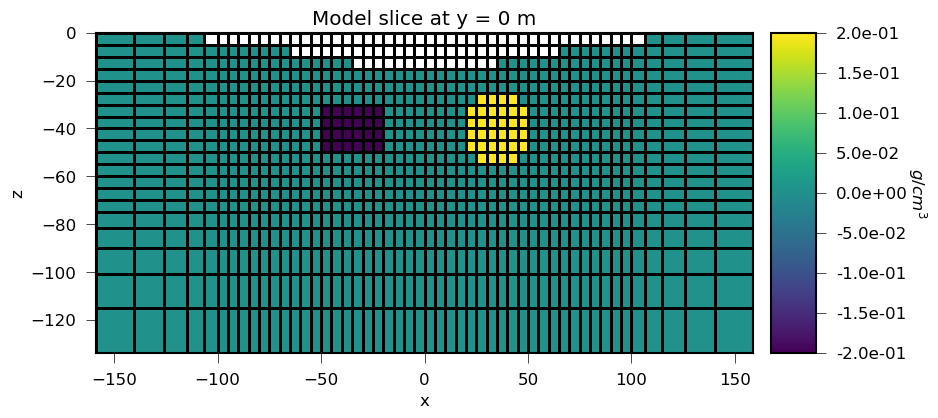

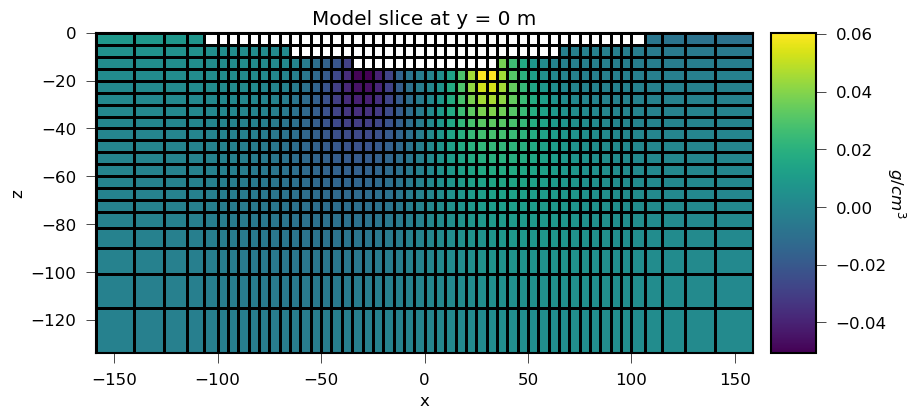

In [36]:
# Plot True Model
fig = plt.figure(figsize=(9, 4))
plotting_map = maps.InjectActiveCells(mesh, ind_active, np.nan)

ax1 = fig.add_axes([0.1, 0.1, 0.73, 0.8])
mesh.plot_slice(
    plotting_map * true_model,
    normal="Y",
    ax=ax1,
    ind=int(mesh.nCy / 2),
    grid=True,
    clim=(np.min(true_model), np.max(true_model)),
    pcolorOpts={"cmap": "viridis"},
)
ax1.set_title("Model slice at y = 0 m")


ax2 = fig.add_axes([0.85, 0.1, 0.05, 0.8])
norm = mpl.colors.Normalize(vmin=np.min(true_model), vmax=np.max(true_model))
cbar = mpl.colorbar.ColorbarBase(
    ax2, norm=norm, orientation="vertical", cmap=mpl.cm.viridis, format="%.1e"
)
cbar.set_label("$g/cm^3$", rotation=270, labelpad=15, size=12)

plt.show()

# Plot Recovered Model
fig = plt.figure(figsize=(9, 4))
plotting_map = maps.InjectActiveCells(mesh, ind_active, np.nan)

ax1 = fig.add_axes([0.1, 0.1, 0.73, 0.8])
mesh.plot_slice(
    plotting_map * recovered_model,
    normal="Y",
    ax=ax1,
    ind=int(mesh.nCy / 2),
    grid=True,
    clim=(np.min(recovered_model), np.max(recovered_model)),
    pcolorOpts={"cmap": "viridis"},
)
ax1.set_title("Model slice at y = 0 m")

ax2 = fig.add_axes([0.85, 0.1, 0.05, 0.8])
norm = mpl.colors.Normalize(vmin=np.min(recovered_model), vmax=np.max(recovered_model))
cbar = mpl.colorbar.ColorbarBase(
    ax2, norm=norm, orientation="vertical", cmap=mpl.cm.viridis
)
cbar.set_label("$g/cm^3$", rotation=270, labelpad=15, size=12)

plt.show()

# <font color='Orange'>MTH5/mt_metadata</font> 

In [37]:
from pathlib import Path
import zipfile
from mth5.mth5 import MTH5
from mth5 import read_file
from mth5.timeseries import ChannelTS, RunTS
import shutil
import numpy as np
from os import path
import os
import glob
import matplotlib.pyplot as plt
import nc_time_axis
import h5py

from mt_metadata import timeseries as metadata
from mt_metadata.utils.mttime import MTime

2023-05-23 16:04:35,063 [line 144] mt_metadata.setup_logger - INFO: Logging file can be found /opt/conda/envs/geophys/lib/python3.9/site-packages/logs/mt_metadata_info.log
2023-05-23 16:04:35,071 [line 144] mt_metadata.base.schema.setup_logger - INFO: Logging file can be found /opt/conda/envs/geophys/lib/python3.9/site-packages/logs/metadata_schema.log
2023-05-23 16:04:35,372 [line 135] mth5.setup_logger - INFO: Logging file can be found /opt/conda/envs/geophys/lib/python3.9/site-packages/logs/mth5_debug.log
2023-05-23 16:04:35,424 [line 144] mt_metadata.utils.mttime.MTime.setup_logger - INFO: Logging file can be found /opt/conda/envs/geophys/lib/python3.9/site-packages/logs/mt_time.log


In [38]:
file1 = '/g/data/my80/AuScope_MT_collection/AuScope_AusLAMP/Musgraves_APY/SA/level_1/Concatenated_Resampled_Rotated_Time_Series_MTH5/SA250.h5'
file2 = '/g/data/my80/AuScope_MT_collection/AuScope_AusLAMP/Musgraves_APY/SA/level_1/Concatenated_Resampled_Rotated_Time_Series_MTH5/SA275.h5'

In [39]:
f1 = h5py.File(file1,'r')
f2 = h5py.File(file2,'r')

In [40]:
station1 = 'SA250'
station2 = 'SA275'
run = '001'

survey_string = 'Experiment/Surveys/AusLAMP_Musgraves'
        
f1_station_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station1
f2_station_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station2

f1_run_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station1 + '/' + run 
f2_run_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station2 + '/' + run 

f1_ex_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station1 + '/' + run + '/'+'ex'
f1_ey_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station1 + '/' + run + '/'+'ey'      
f1_bx_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station1 + '/' + run + '/'+'bx'
f1_by_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station1 + '/' + run + '/'+'by'
f1_bz_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station1 + '/' + run + '/'+'bz'

f2_ex_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station2 + '/' + run + '/'+'ex'
f2_ey_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station2 + '/' + run + '/'+'ey'      
f2_bx_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station2 + '/' + run + '/'+'bx'
f2_by_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station2 + '/' + run + '/'+'by'
f2_bz_string = 'Experiment/Surveys/AusLAMP_Musgraves/Stations/'+ station2 + '/' + run + '/'+'bz'

In [41]:
ex_f1 = f1[f1_ex_string]
by_f1 = f1[f1_by_string]

ex_f2 = f2[f2_ex_string]
by_f2 = f2[f2_by_string]

### Query mt_metadata

In [42]:
f1[f1_run_string].attrs.keys()

<KeysViewHDF5 ['acquired_by.author', 'channels_recorded_auxiliary', 'channels_recorded_electric', 'channels_recorded_magnetic', 'data_logger.firmware.author', 'data_logger.firmware.name', 'data_logger.firmware.version', 'data_logger.id', 'data_logger.manufacturer', 'data_logger.model', 'data_logger.power_source.type', 'data_logger.timing_system.drift', 'data_logger.timing_system.type', 'data_logger.timing_system.uncertainty', 'data_logger.type', 'data_type', 'hdf5_reference', 'id', 'metadata_by.author', 'mth5_type', 'sample_rate', 'time_period.end', 'time_period.start']>

In [43]:
f1[f1_run_string].attrs['sample_rate']

1.0

### Plot MTH5 time series data

In [44]:
import plotly.graph_objects as go

In [45]:
ex_250 = ex_f1[100000:101000]-np.mean(ex_f1[100000:101000])
by_250 = by_f1[100000:101000]-np.mean(by_f1[100000:101000])

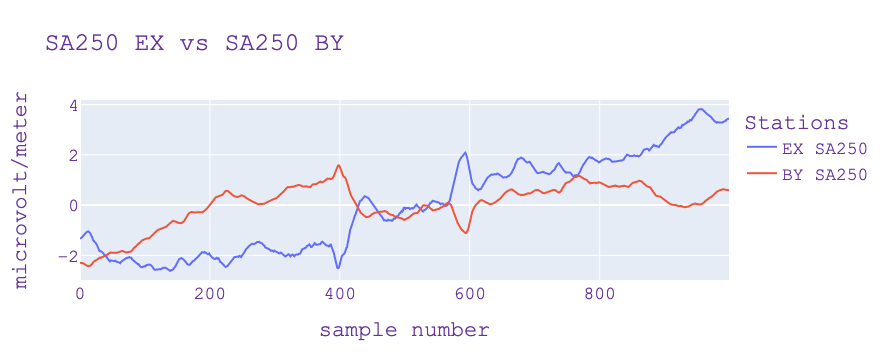

In [46]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=ex_250,
    name="EX SA250"       # this sets its legend entry
))


fig.add_trace(go.Scatter(y=by_250,
    name="BY SA250"       # this sets its legend entry
))

# fig.add_trace(go.Scatter(
#     x=[0, 1, 2, 3, 4, 5, 6, 7, 8],
#     y=[1, 0, 3, 2, 5, 4, 7, 6, 8],
#     name="Name of Trace 2"
# ))


#fig = px.line(ex_250)
#fig = px.line(by_275)
fig.update_layout(
    title="SA250 EX vs SA250 BY",
    xaxis_title="sample number",
    yaxis_title="microvolt/meter",
    legend_title="Stations",
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="RebeccaPurple"
    )
)

fig.show()

# <font color='Orange'>Visualisation libraries</font>

In [47]:
import hvplot.networkx as hvnx
import networkx as nx

G = nx.petersen_graph()
hvnx.draw(G, with_labels=True)

:Overlay
   .Graph.I  :Graph   [start,end]
   .Labels.I :Labels   [x,y]   (index)

In [48]:
import hvplot.xarray  # noqa
import xarray as xr

xr_ds = xr.tutorial.open_dataset('air_temperature').load().sel(time='2013-06-01 12:00')
xr_ds.hvplot()

:Image   [lon,lat]   (air)

<AxesSubplot: >

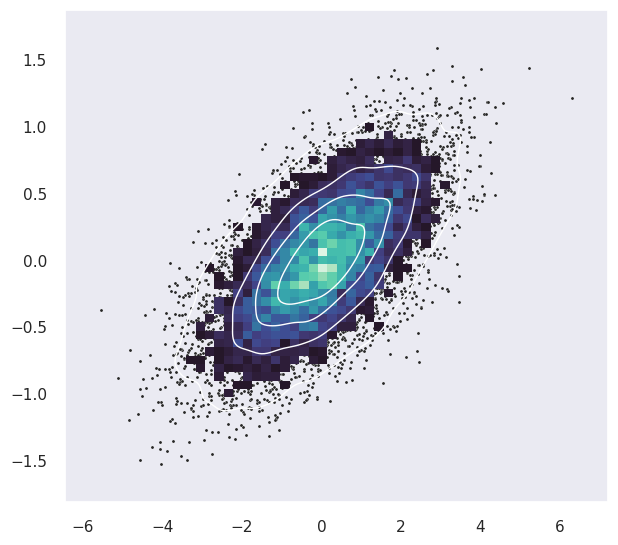

In [49]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_theme(style="dark")

# Simulate data from a bivariate Gaussian
n = 10000
mean = [0, 0]
cov = [(2, .4), (.4, .2)]
rng = np.random.RandomState(0)
x, y = rng.multivariate_normal(mean, cov, n).T

# Draw a combo histogram and scatterplot with density contours
f, ax = plt.subplots(figsize=(6, 6))
sns.scatterplot(x=x, y=y, s=5, color=".15")
sns.histplot(x=x, y=y, bins=50, pthresh=.1, cmap="mako")
sns.kdeplot(x=x, y=y, levels=5, color="w", linewidths=1)

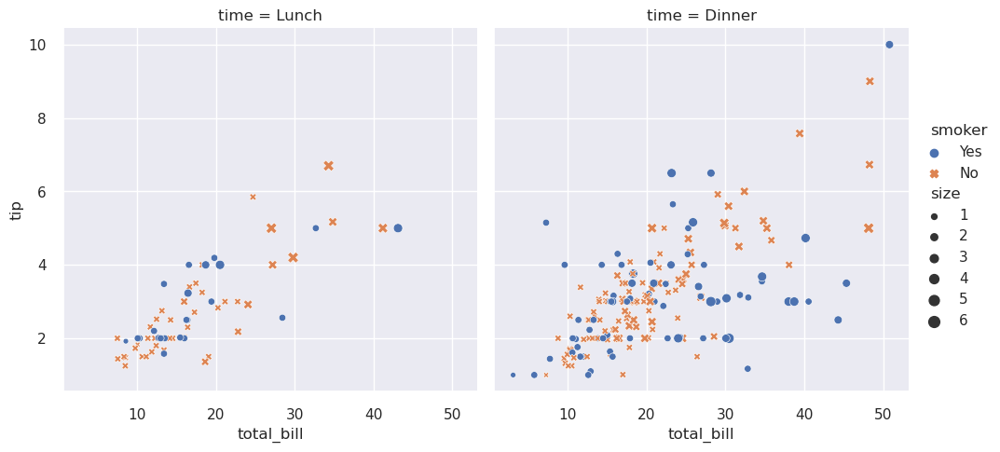

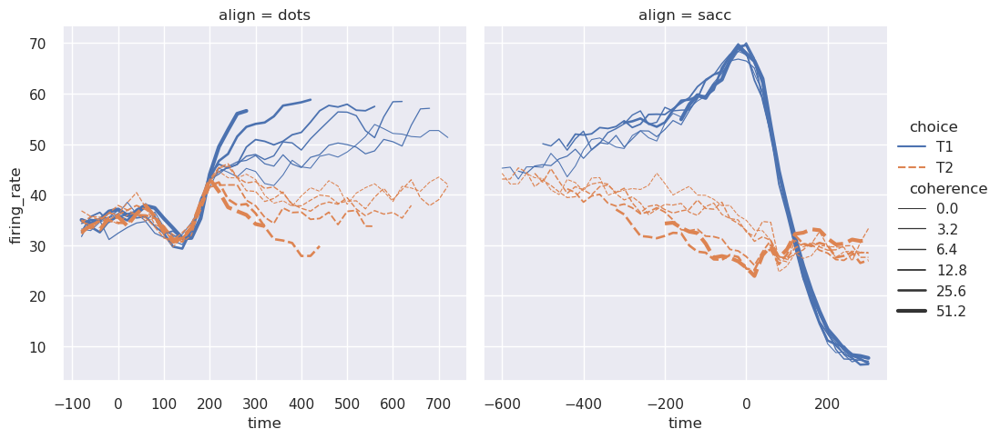

In [50]:
# Import seaborn
import seaborn as sns

# Apply the default theme
sns.set_theme()

# Load an example dataset
tips = sns.load_dataset("tips")

# Create a visualization
sns.relplot(
    data=tips,
    x="total_bill", y="tip", col="time",
    hue="smoker", style="smoker", size="size",
)


dots = sns.load_dataset("dots")
sns.relplot(
    data=dots, kind="line",
    x="time", y="firing_rate", col="align",
    hue="choice", size="coherence", style="choice",
    facet_kws=dict(sharex=False),
)


In [51]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

import plotly.express as px

fig = px.choropleth_mapbox(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()